## TODO Recording

- Please do this in a terminal window

`mkdir ai_workshop_gans`

`cd ai_workshop_gans`

`python3 -m venv pytorch_venv`

`source pytorch_venv/bin/activate`

#### Environment activation for Windows (FYI nothing for the recording)

`pytorch_venv\Scripts\activate.bat`

Setting up Kernel specific to pytorch_venv

## TODO Recording

- IPython kernel (ipykernel) is a Python package that provides the communication between the Jupyter Notebook or JupyterLab interface and the Python kernel. It enables you to run Python code interactively and display the output within the notebook environment.

`pip install ipykernel`


- This will list the kernels available (only one Python3 kernel)

`jupyter kernelspec list`

- Install and make the pytorch_venv kernel available to Jupyter Notebooks

`python -m ipykernel install --user --name=pytorch_venv`

- Now we have 2 kernels available

`jupyter kernelspec list`

- Upgrade pip

pip install --upgrade pip

- Required libraries in virtual environment

`pip install torch torchvision matplotlib tqdm`

- Start jupyter notebook

`jupyter notebook`

Importing required packages

In [5]:
import os
import torch
import torchvision
import torch.nn as nn

from torchvision import transforms  #transform images
from tqdm import tqdm  #display a progress bar that updates as the loop iterates, making it easier to monitor the progress of long-running tasks.

In [6]:
if not os.path.exists('data'):
    os.makedirs('data')

## TODO Recording

- Go to the home page and show the data/ folder

In [8]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(
        mean =  [0.5], std = [0.5]
    )
])

transform

Compose(
    ToTensor()
    Normalize(mean=[0.5], std=[0.5])
)

In [12]:
fmnist_data = torchvision.datasets.FashionMNIST(
    root = 'data/', train = True, transform = transform, download = True
)
#train = True: This indicates that you want to download the training set of the Fashion-MNIST dataset. If set to False, it would download the test set.


100%|█████████████████████████████████████████████████████████████████| 26421880/26421880 [00:16<00:00, 1644778.67it/s]


Extracting data/FashionMNIST\raw\train-images-idx3-ubyte.gz to data/FashionMNIST\raw



100%|████████████████████████████████████████████████████████████████████████| 29515/29515 [00:00<00:00, 492937.65it/s]


Extracting data/FashionMNIST\raw\train-labels-idx1-ubyte.gz to data/FashionMNIST\raw



100%|███████████████████████████████████████████████████████████████████| 4422102/4422102 [00:02<00:00, 1709808.03it/s]


Extracting data/FashionMNIST\raw\t10k-images-idx3-ubyte.gz to data/FashionMNIST\raw



100%|██████████████████████████████████████████████████████████████████████████████████████| 5148/5148 [00:00<?, ?it/s]

Extracting data/FashionMNIST\raw\t10k-labels-idx1-ubyte.gz to data/FashionMNIST\raw



Original Pixel Values: The pixel values in grayscale images range from 0 to 1, where 0 represents black and 1 represents white.
Normalization Formula: In the video, the images are normalized by subtracting 0.5 from each pixel value and then dividing by 0.5. This centers the pixel values around 0.

In [19]:
batch_size = 16

fmnist_dl = torch.utils.data.DataLoader(
    dataset = fmnist_data, batch_size = batch_size,
    shuffle = True, drop_last = True # Drops the last batch if it contains fewer images than the specified batch size 16
)

fmnist_dl

There are total 60000 training images , so by dividing 60k by batch size , length of dataloader is obtained i.e 60000/16=3750

In [22]:
len(fmnist_dl)

3750

Extracting some random batch of training images

In [25]:
dataiter = iter(fmnist_dl) #creates an iterator from the DataLoader fmnist_dl. An iterator allows you to go through the dataset batch by batch.

images, labels = next(dataiter) #retrieves the next batch of images and labels from the iterator. Since the batch size is set to 16, images will contain 16 images, and labels will contain the corresponding labels.

In [29]:
images.shape, labels.shape
#16: Batch size (number of images in a batch)
#1: Number of channels (grayscale images have 1 channel)
#28, 28: Height and width of each image (28x28 pixels)

#16: Batch size (number of labels corresponding to the images)

(torch.Size([16, 1, 28, 28]), torch.Size([16]))

Classes of Fashion MNIST clothing images are defined

In [34]:
classes = [
    't_shirt/top', 
    'trouser', 
    'pullover', 
    'dress', 
    'coat',
    'sandal', 
    'shirt', 
    'sneaker', 
    'bag', 
    'ankle_boots'
]

Defining functions to display few images from the dataset

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from torchvision.utils import make_grid

def display(img):
    
    # unnormalize: reverses the normalization applied earlier (which was (img - 0.5) / 0.5)
    img = img / 2 + 0.5     

    #PyTorch tensors have dimensions (channels, height, width), but matplotlib expects (height, width, channels). 
    img = img.permute(1, 2, 0) 

    #Converts the PyTorch tensor to a NumPy array for compatibility with matplotlib.
    npimg = img.numpy()
    
    plt.imshow(npimg)
    #plt.xticks([]) #Removes the axis ticks for a cleaner display.
    plt.yticks([])
    plt.show()

In [3]:
display(make_grid(images, 4))

print(' '.join(f'{classes[labels[j]]:5s}' for j in range(16)))

NameError: name 'images' is not defined


Defining Hyperparameters for Generator and Discriminator Network

In [14]:
latent_size = 100

# 28 x 28
image_size = 784 

The generator, G, is designed to map the latent space vector (z) to data-space. Since our data are images, converting
z to data-space means ultimately creating a Grey scale image with the same size as the training images (i.e. 1x28x28). The output of the generator is fed through a tanh function to return it to the input data range of [-1,1]

In [15]:
class Generator(nn.Module):
    
    def __init__(self):
        super(Generator, self).__init__()
        
        self.net = nn.Sequential(
            nn.Linear(100, 64),
            nn.ReLU(),
            
            nn.Linear(64, 128),
            nn.ReLU(),
            
            nn.Linear(128, 256),
            nn.ReLU(),
            
            nn.Linear(256, 784),
            nn.Tanh()  
            #tan always used for generator because it produces output between -1 and 1 this matches the pixel values of real data(already normalized between -1 and 1)
        )

    def forward(self, x): #pass through the generator
        
        return self.net(x)

Instantiating Generator network and display the network

In [16]:
netG = Generator()

print(netG)

Generator(
  (net): Sequential(
    (0): Linear(in_features=100, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=128, bias=True)
    (3): ReLU()
    (4): Linear(in_features=128, out_features=256, bias=True)
    (5): ReLU()
    (6): Linear(in_features=256, out_features=784, bias=True)
    (7): Tanh()
  )
)


As mentioned, the discriminator, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real (as opposed to fake). Here,it takes a 1x28x28 input image, processes it through a series of Linear, and LeakyReLU layers, and outputs the final probability through a Sigmoid activation function.

In [17]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.net = nn.Sequential(
            nn.Linear(784, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(p = 0.2),
            
            nn.Linear(256, 128),
            nn.LeakyReLU(0.2),
            nn.Dropout(p = 0.2),
            
            nn.Linear(128, 64),
            nn.LeakyReLU(0.2),  #for negative values, LeakyReLU returns a slight negative value rather than 0
            nn.Dropout(p = 0.2),
            
            nn.Linear(64, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.net(x)

Instantiating Generator network and display the network

In [18]:
netD = Discriminator()

print(netD)

Discriminator(
  (net): Sequential(
    (0): Linear(in_features=784, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.2, inplace=False)
    (3): Linear(in_features=256, out_features=128, bias=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.2, inplace=False)
    (6): Linear(in_features=128, out_features=64, bias=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.2, inplace=False)
    (9): Linear(in_features=64, out_features=1, bias=True)
    (10): Sigmoid()
  )
)


Random value inputs (batch size 64) as Input to Generator

In [19]:
z = torch.randn(64, latent_size)
#generates a tensor of shape (64, latent_size) filled with random numbers drawn from a standard normal distribution

sample_gen_output = netG(z)

sample_gen_output

tensor([[ 0.0737, -0.0523, -0.1593,  ...,  0.0106, -0.0326,  0.0542],
        [ 0.0896,  0.0101, -0.0851,  ...,  0.0322, -0.0143,  0.0539],
        [ 0.0831, -0.0394, -0.0692,  ...,  0.0309, -0.0254,  0.0312],
        ...,
        [ 0.0829, -0.0248, -0.1021,  ...,  0.0189, -0.0435,  0.0224],
        [ 0.0674, -0.0049, -0.0832,  ...,  0.0090, -0.0246,  0.0440],
        [ 0.0716, -0.0578, -0.0604,  ...,  0.0366, -0.0061,  0.0692]],
       grad_fn=<TanhBackward0>)

64 vectors and every vector corresponds to a generated image(flatten pixels)

Shape of Flattened output of images is checked

In [20]:
sample_gen_output.shape

torch.Size([64, 784])

Minimum and maximum values of pixel output from Generator are obtained which are well within the range of TanH output range of  -1 to 1

In [21]:
torch.min(sample_gen_output).item(), torch.max(sample_gen_output).item()

(-0.23477856814861298, 0.22819070518016815)

Reshape the output into 64 images of 28 X 28  and plotting an instance, Random noise is generated

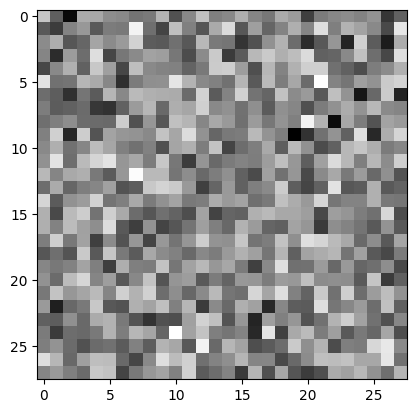

In [22]:
generated_images = sample_gen_output.reshape(64, 1, 28, 28)
#the reshape to pytoch format: (batches,channels, height, width)

plt.imshow(generated_images[0, 0, :, :].detach().numpy(), cmap = 'gray')

Display images in a grid layout.Generated images are entirely random since we have not trained the generator network, and its parameters (weights and biases) are completely random at this stage.

In [23]:
generated_images.shape

torch.Size([64, 1, 28, 28])

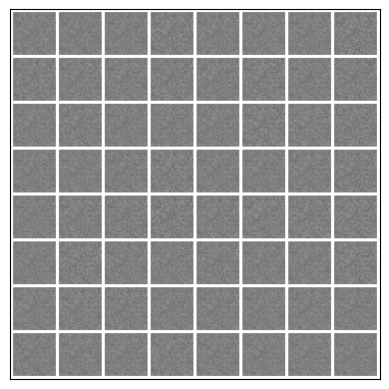

In [24]:
display(make_grid(generated_images, nrow = 8 , pad_value = 1.0))

Let’s feed an batch of  image generated by the untrained generator network into the discriminator: Predictions are random

In [25]:
netD.eval()

with torch.no_grad():
    prediction = netD(generated_images.reshape(-1, 784)) #reshape: flatten the image to one dimensional vector

print(prediction[:20])

tensor([[0.4951],
        [0.4954],
        [0.4952],
        [0.4952],
        [0.4947],
        [0.4951],
        [0.4950],
        [0.4955],
        [0.4949],
        [0.4952],
        [0.4952],
        [0.4953],
        [0.4951],
        [0.4957],
        [0.4954],
        [0.4955],
        [0.4953],
        [0.4949],
        [0.4951],
        [0.4954]])


all the probabilities are the same 

Let’s feed an batch of  real images from Fashion mnist into the discriminator: Predictions are random

In [26]:
netD.eval()

with torch.no_grad():
    prediction_real = netD(images.reshape(-1, 784))

print(prediction_real[:20])

tensor([[0.4915],
        [0.4843],
        [0.4800],
        [0.4885],
        [0.4859],
        [0.4887],
        [0.4867],
        [0.4881],
        [0.4947],
        [0.4839],
        [0.4849],
        [0.4871],
        [0.4797],
        [0.4894],
        [0.4900],
        [0.4881]])


With D and G setup, we can specify how they learn through the loss functions and optimizers. We will use the Binary Cross Entropy loss (BCELoss) function which is defined in PyTorch as:

In [27]:
criterion = nn.BCELoss()

criterion

BCELoss()

During training, the discriminator predicts whether an input image is real or fake. We calculate the loss value and apply back-propagation so that the optimizer can adjust network parameters (weights and biases).

In [28]:
import torch.optim as optim

lr = 0.0002

d_optimizer = optim.Adam(netD.parameters(), lr = lr)

g_optimizer = optim.Adam(netG.parameters(), lr = lr)

In [29]:
real_label = 1.

fake_label = 0.

D(x)( Real score) is the discriminator network which outputs the (scalar) probability that x came from training data rather than the generator. Here, since we are dealing with images, the input to D(x) is an image of CHW size 1x28x28. Intuitively, D(x) should be HIGH when x comes from training data and LOW when x comes from the generator.We are training only the Discriminator network. So after running for 1 epoch only, D_total_loss has become zero. Discriminator is perfect one as
D(x) can also be thought of as a traditional binary classifier. is becoming 1 and D(G(z)( Fake score) which is the probability (scalar) that the output of the generator G is a real image is becoming 0
It is a usual supervised training for a classification model. The discriminator will learn to distinguish between real (FMNIST) images and fake (generated) images. However, the generator network learns nothing in the below training.

## TODO Recording:

- Make sure you scroll the output and show that the discriminator does too well very quickly

In [30]:
# On training mode
netD.train()

# On eval mode
netG.eval()

num_epochs = 1

for epoch in tqdm(range(num_epochs)):
    for i, data in enumerate(fmnist_dl, 0):
        ## Train with all-real batch
        netD.zero_grad()
        
        # Format batch
        real_images = data[0].reshape(batch_size, 1, 784)

        real_labels = torch.full((batch_size,), real_label, dtype=torch.float)
        
        # Forward pass real batch through D
        #view(-1): flatten the tensor received at the output of the D , this tensor contains probabilities scores
        output = netD(real_images).view(-1)
        
        # Discriminator to should classify real images as real
        # Maximize the probability of this
        errD_real = criterion(output, real_labels)
        
        # Calculate gradients for D in backward pass
        errD_real.backward()
        
        D_x = output.mean().item()

        # Generate fake image batch with G
        noise = torch.randn(batch_size, 100)
        
        fake_images = netG(noise)
        fake_labels = torch.full((batch_size,), fake_label, dtype=torch.float)

        # Classify all fake batch with D
        output = netD(fake_images.detach()).view(-1)
        
        # Discriminator to should classify fake images as fake
        # Maximize the probability of this
        errD_fake = criterion(output, fake_labels)
        
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        
        D_G_z1 = output.mean().item()
        
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        
        # Update D
        d_optimizer.step()

        if i%100 == 0:
            print(f"""Epoch {epoch+0:01}: |
                      D_real Loss: {errD_real:.3f} | 
                      D_fake Loss: {errD_fake:.3f} | 
                      D_total Loss: {errD:.3f} | 
                      Fake_score {D_G_z1:.3f}| 
                      Real_score {D_x:.3f}""")


  0%|                                                     | 0/1 [00:00<?, ?it/s]

Epoch 0: |
                      D_real Loss: 0.719 | 
                      D_fake Loss: 0.684 | 
                      D_total Loss: 1.403 | 
                      Fake_score 0.495| 
                      Real_score 0.487
Epoch 0: |
                      D_real Loss: 0.000 | 
                      D_fake Loss: 0.014 | 
                      D_total Loss: 0.014 | 
                      Fake_score 0.014| 
                      Real_score 1.000
Epoch 0: |
                      D_real Loss: 0.000 | 
                      D_fake Loss: 0.001 | 
                      D_total Loss: 0.001 | 
                      Fake_score 0.001| 
                      Real_score 1.000
Epoch 0: |
                      D_real Loss: 0.000 | 
                      D_fake Loss: 0.001 | 
                      D_total Loss: 0.001 | 
                      Fake_score 0.001| 
                      Real_score 1.000
Epoch 0: |
                      D_real Loss: 0.000 | 
                      D_fake Loss: 0.000 | 
     

Epoch 0: |
                      D_real Loss: 0.000 | 
                      D_fake Loss: 0.000 | 
                      D_total Loss: 0.000 | 
                      Fake_score 0.000| 
                      Real_score 1.000


100%|█████████████████████████████████████████████| 1/1 [00:46<00:00, 46.74s/it]


Defining a function to display images and save images

In [31]:
def display_image_grid(epoch: int, step: int,  images: torch.Tensor, nrow: int):
    images = images / 2 + 0.5
    
    image_grid = make_grid(images, nrow)     # Images in a grid
    image_grid = image_grid.permute(1, 2, 0) # Move channel last
    image_grid = image_grid.cpu().numpy()    # To Numpy

    plt.imshow(image_grid)
    
    plt.xticks([])
    plt.yticks([])

    plt.show()
    plt.close()

In [32]:
netG = Generator()

nedD = Discriminator()

d_optimizer = optim.Adam(netD.parameters(), lr = lr)

g_optimizer = optim.Adam(netG.parameters(), lr = lr)

Now we will be training our generator first alone without training Discriminator. Restart kernel and dont train Discriminator

When we train the generator, we want it to generate images as if they come from Fashion_MNIST. As such, we use real_targets as labels, and use the discriminator to calculate the loss.Here the discriminator couldn’t distinguish between real and fake images well, and the loss value is not very useful

## TODO Recording:

- Make sure you scroll the output slowly to show clearly that the generator does not improve even after 5 epochs of training


  0%|                                                     | 0/5 [00:00<?, ?it/s]

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


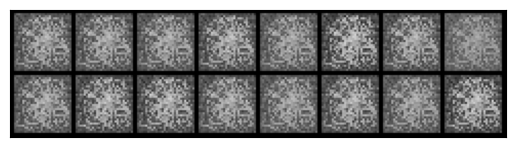

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


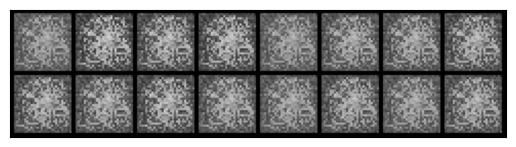

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


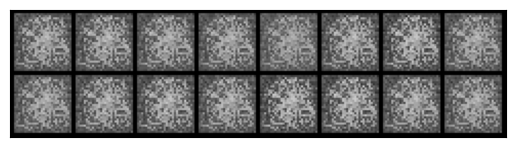

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


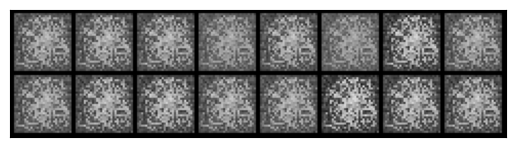

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


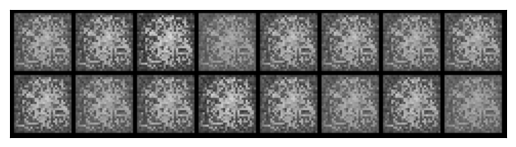

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


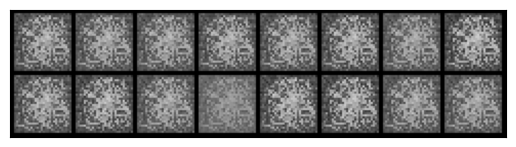

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


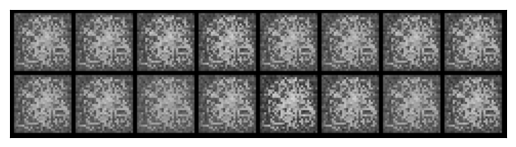

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


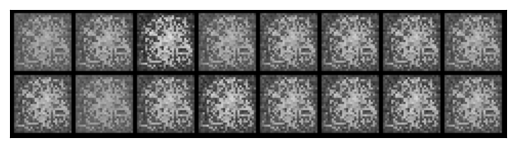

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


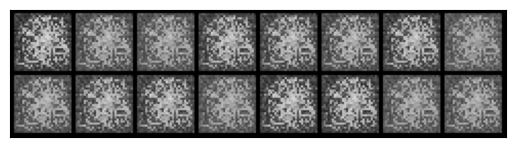

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


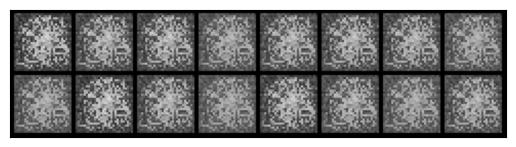

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


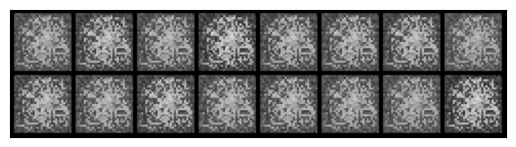

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


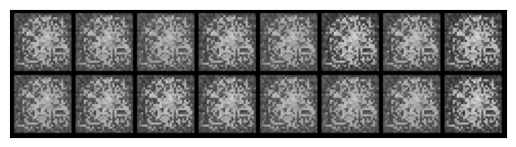

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


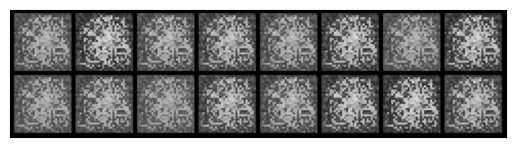

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


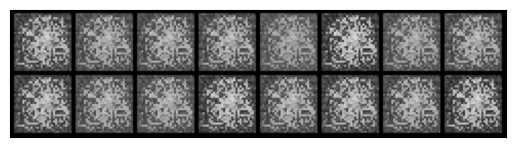

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


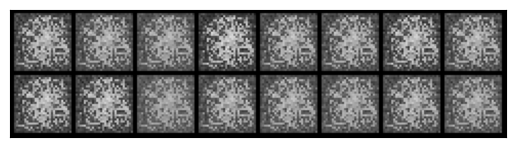

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


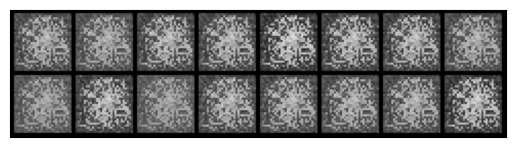

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


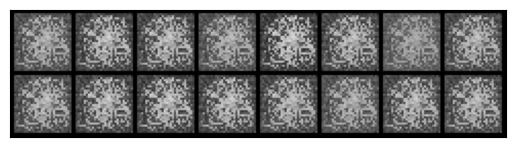

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


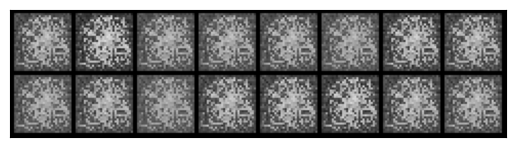

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


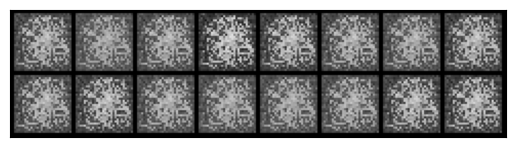

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


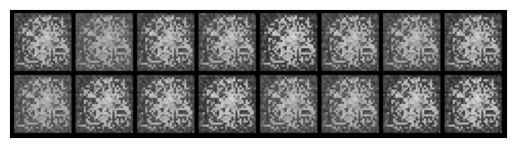

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


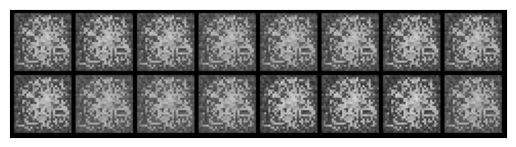

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


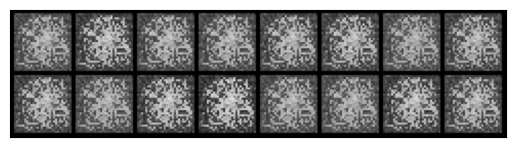

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


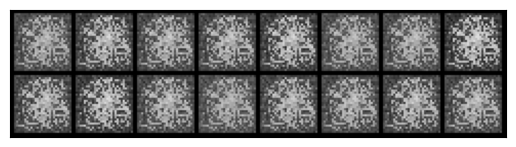

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


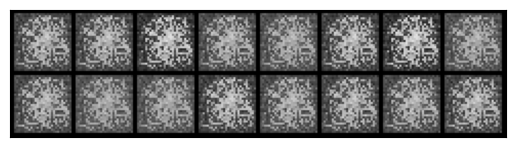

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


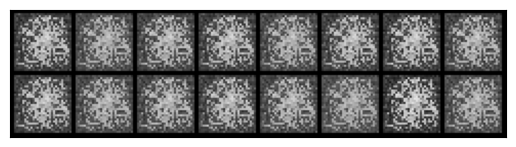

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


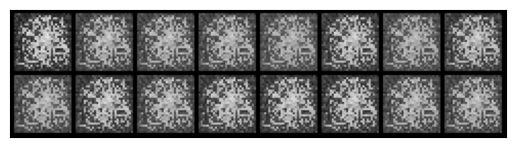

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


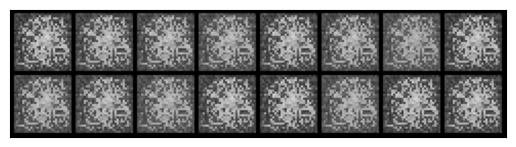

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


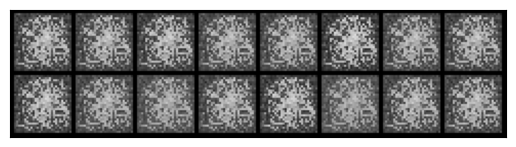

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


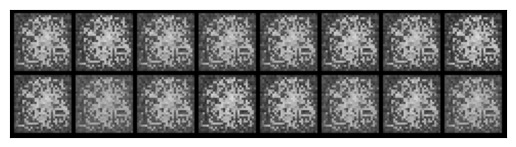

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


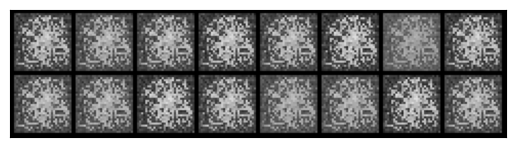

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


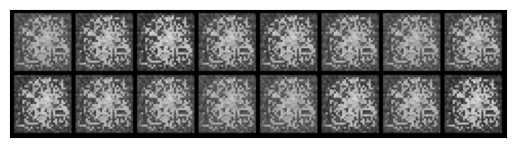

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


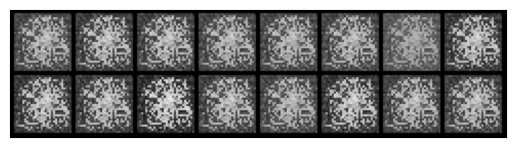

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


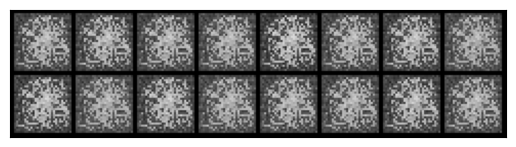

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


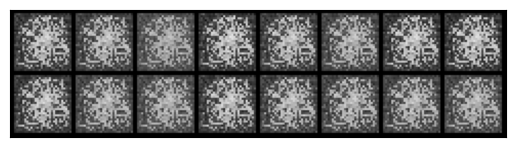

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


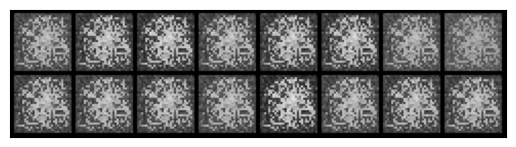

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


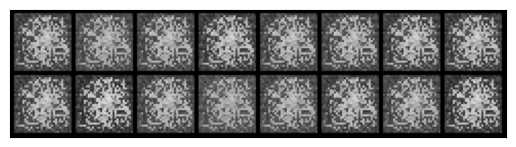

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


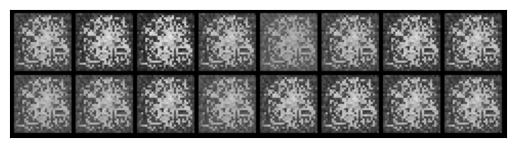

Epoch 0: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


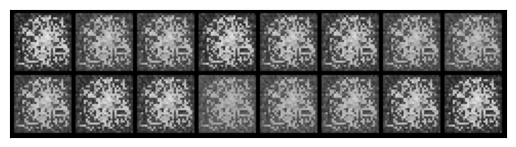


 20%|█████████                                    | 1/5 [00:50<03:20, 50.09s/it]

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


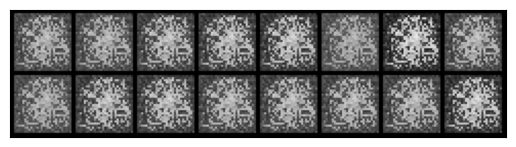

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


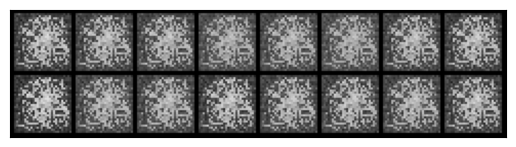

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


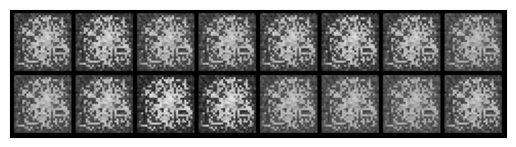

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


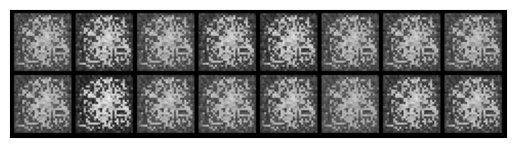

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


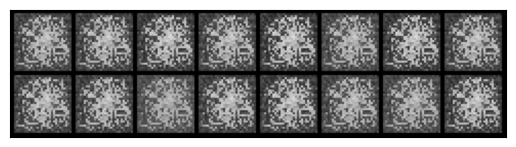

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


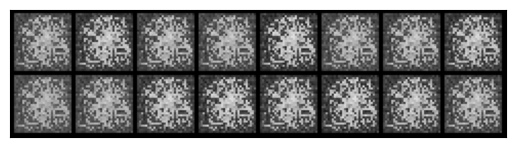

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


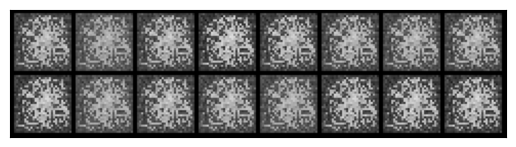

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


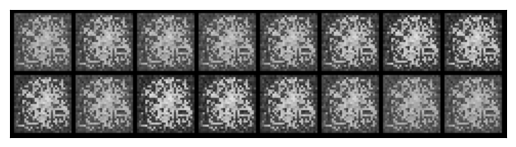

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


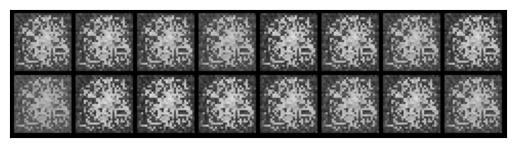

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


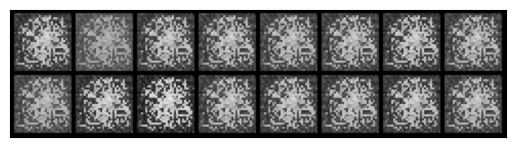

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


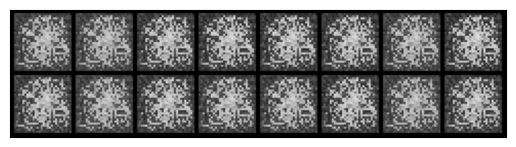

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


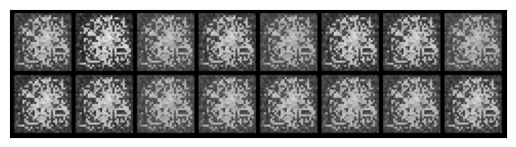

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


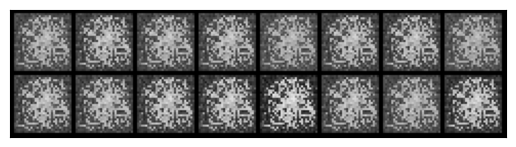

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


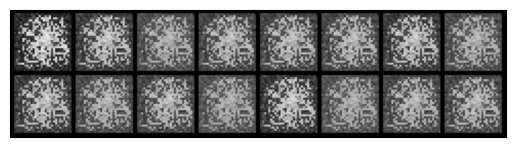

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


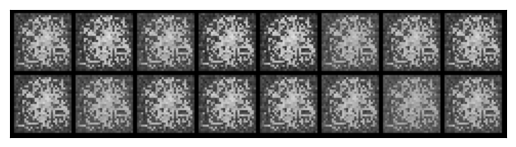

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


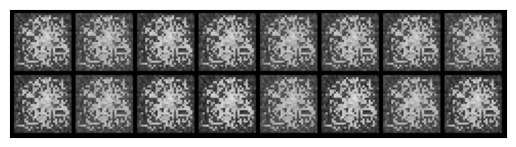

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


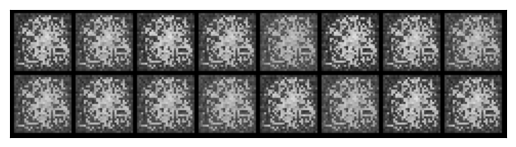

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


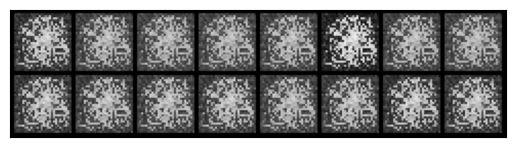

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


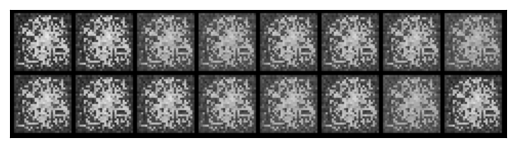

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


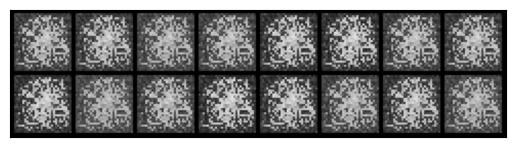

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


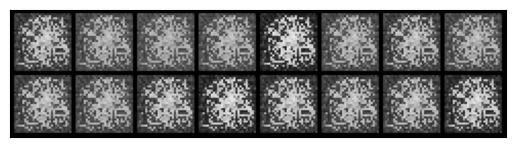

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


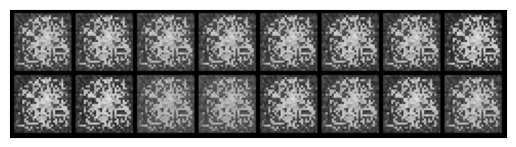

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


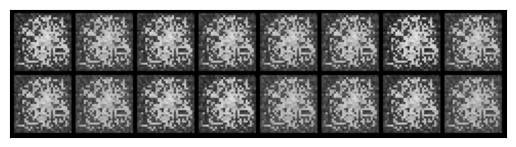

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


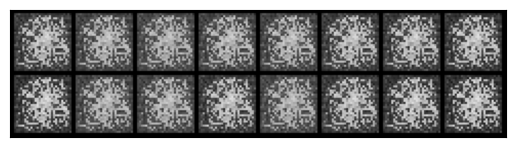

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


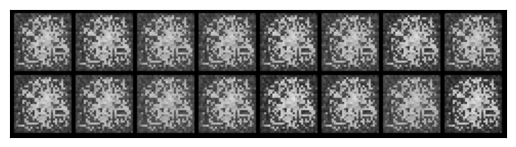

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


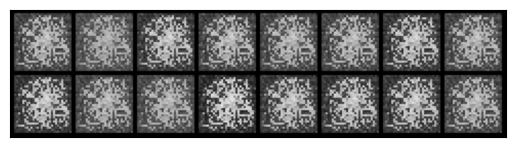

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


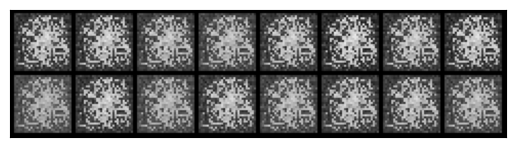

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


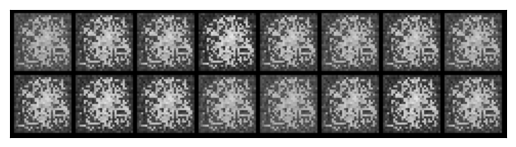

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


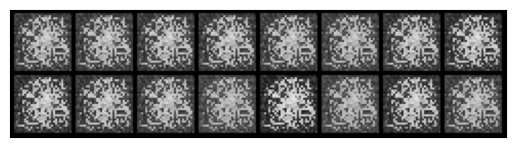

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


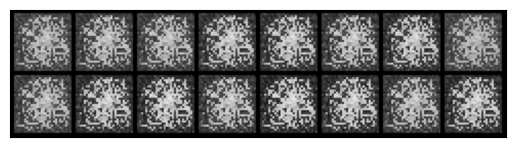

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


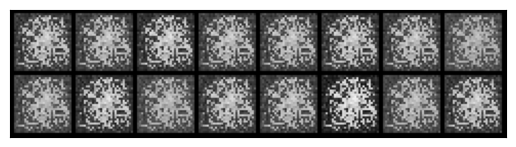

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


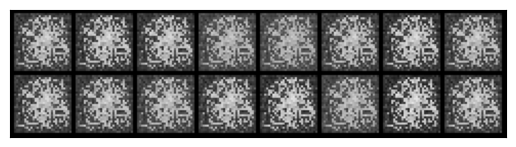

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


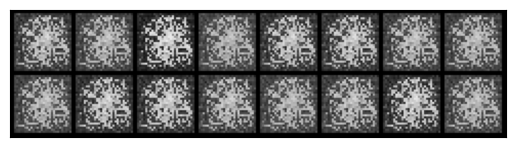

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


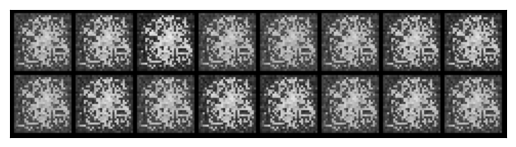

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


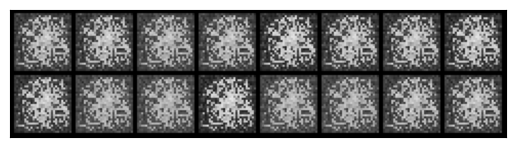

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


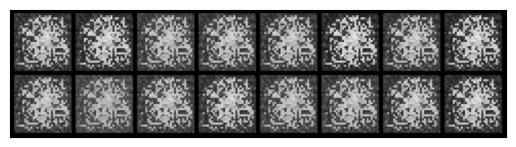

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


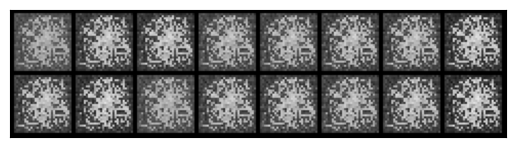

Epoch 1: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


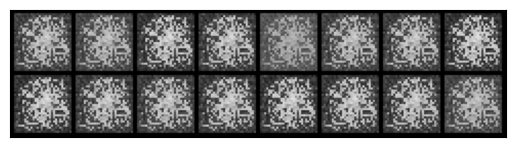


 40%|██████████████████                           | 2/5 [01:32<02:17, 45.78s/it]

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


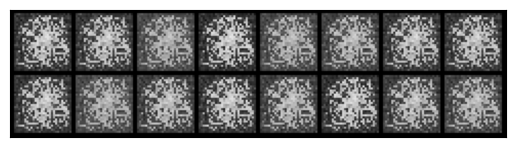

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


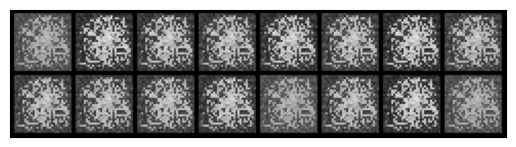

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


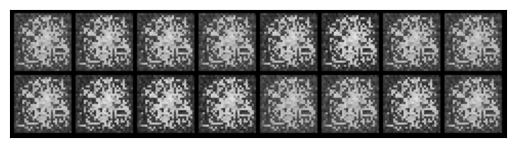

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


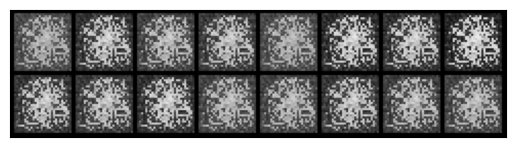

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


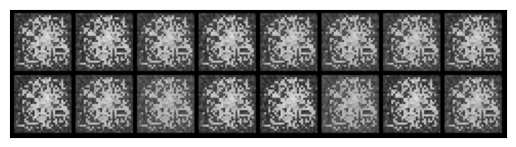

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


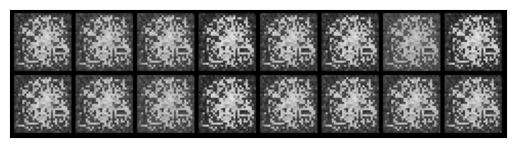

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


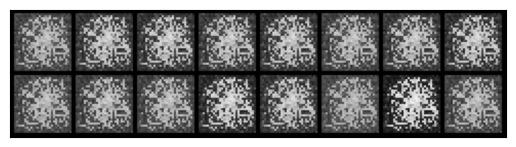

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


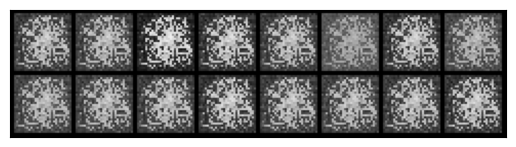

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


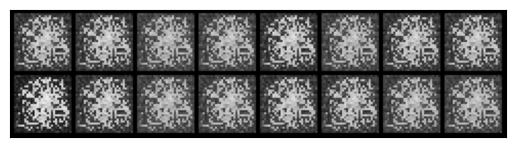

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


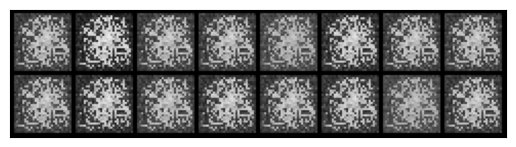

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


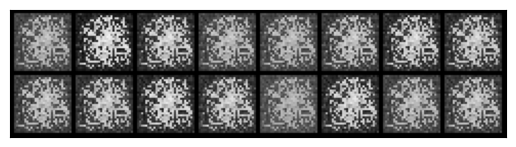

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


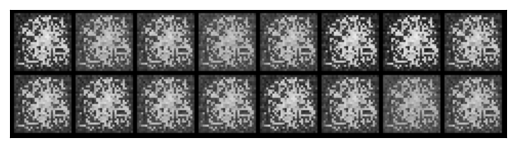

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


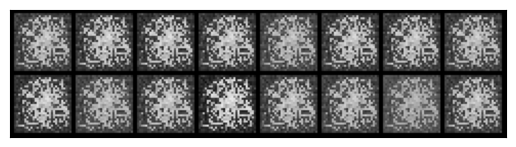

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


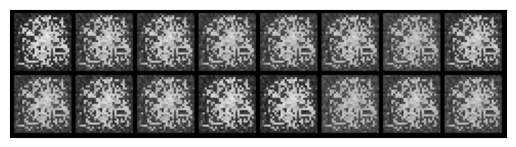

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


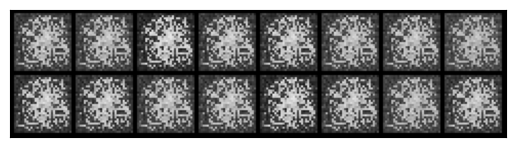

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


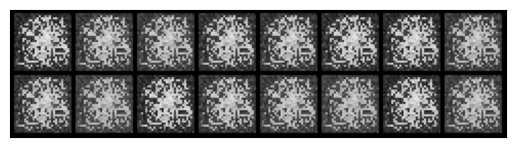

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


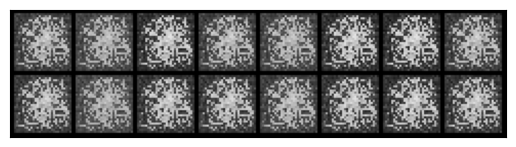

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


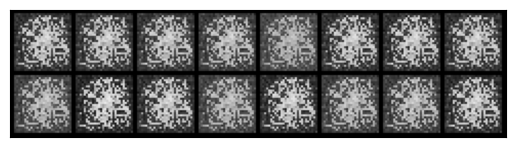

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


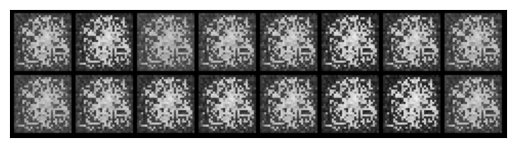

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


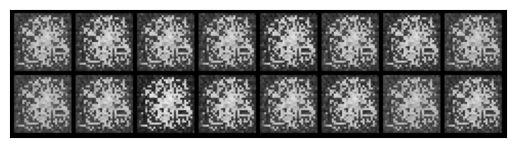

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


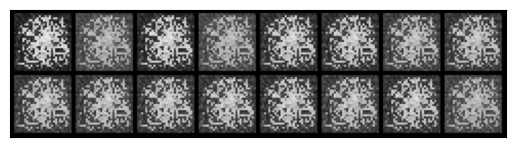

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


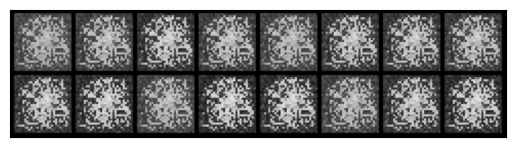

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


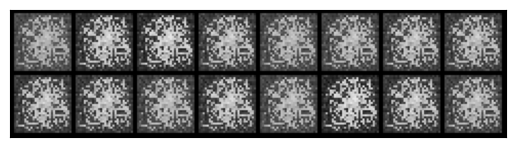

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


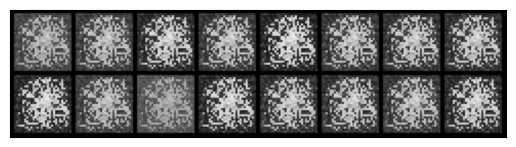

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


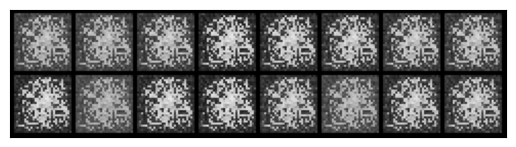

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


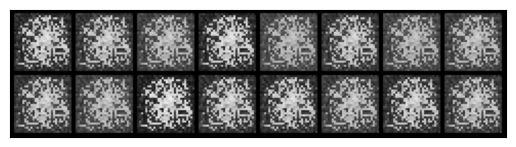

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


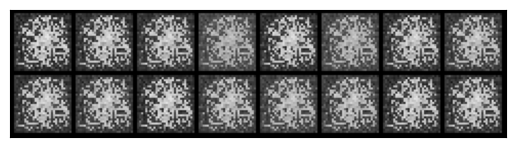

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


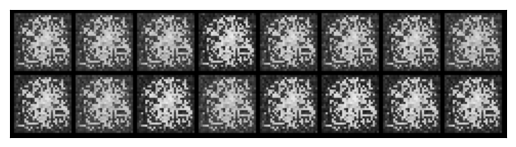

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


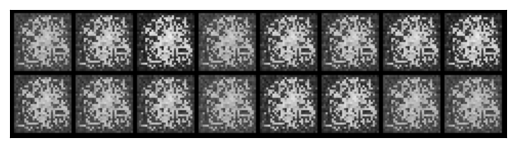

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


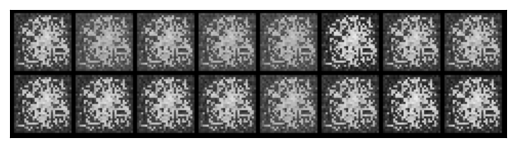

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


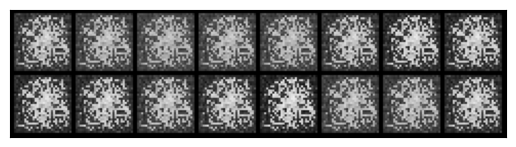

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


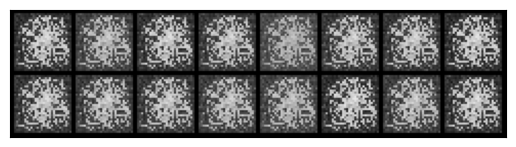

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


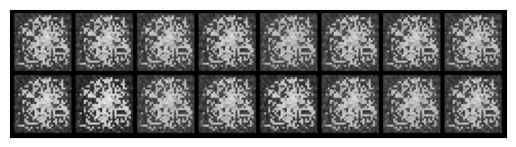

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


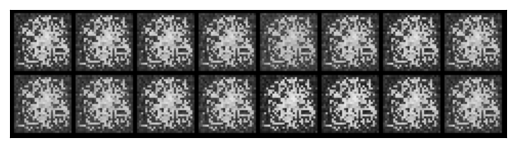

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


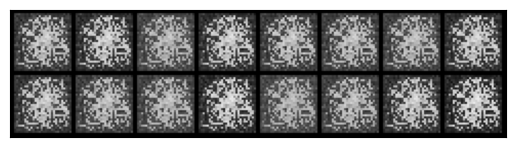

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


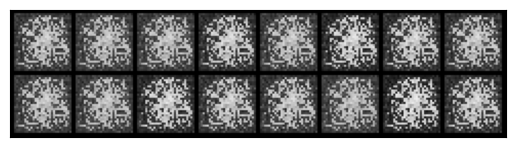

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


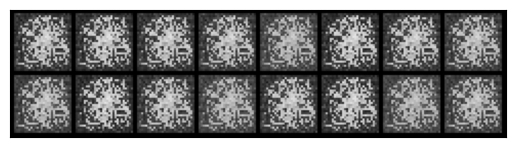

Epoch 2: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


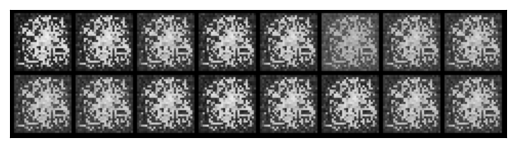


 60%|███████████████████████████                  | 3/5 [02:10<01:24, 42.17s/it]

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


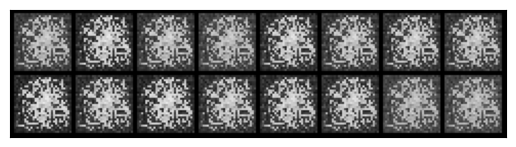

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


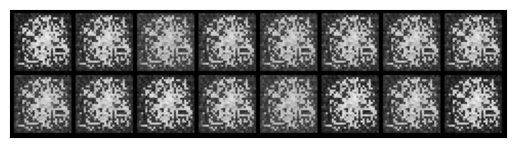

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


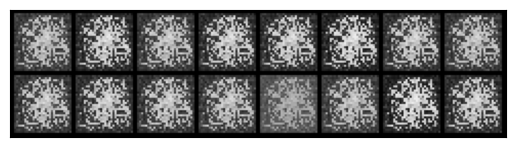

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


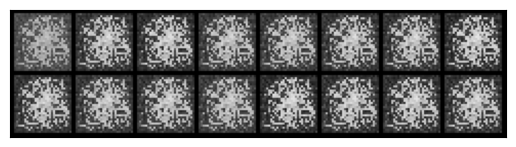

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


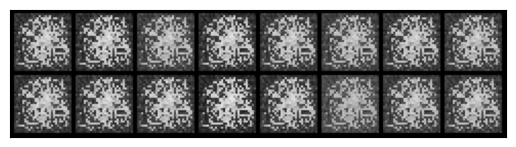

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


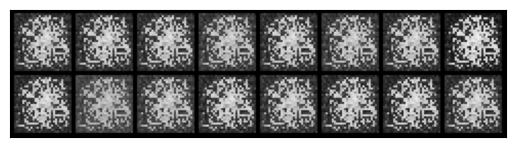

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


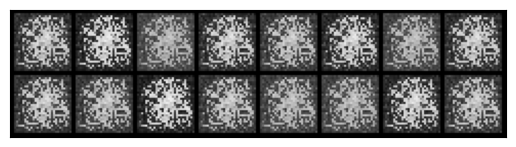

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


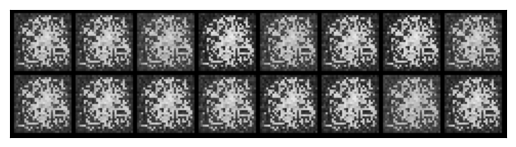

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


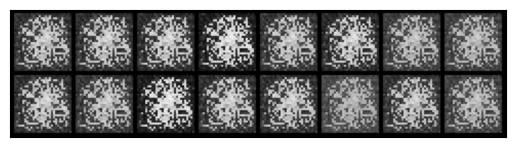

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


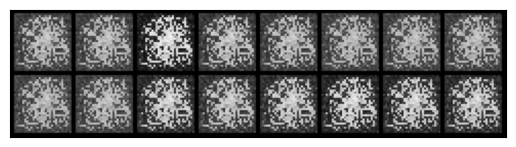

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


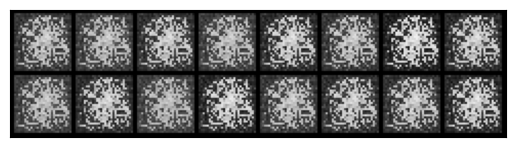

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


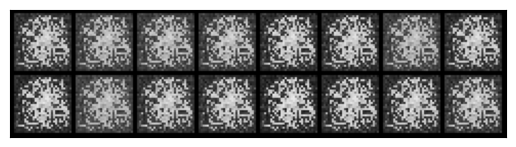

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


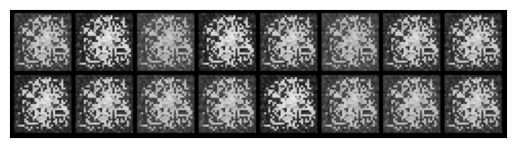

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


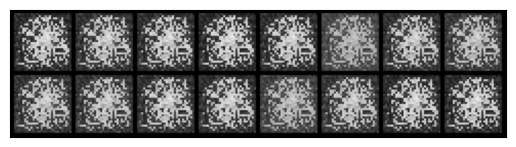

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


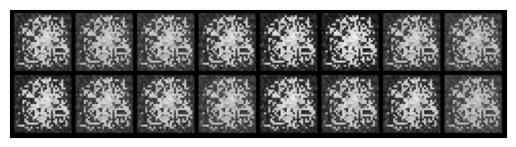

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


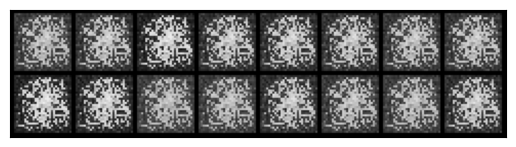

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


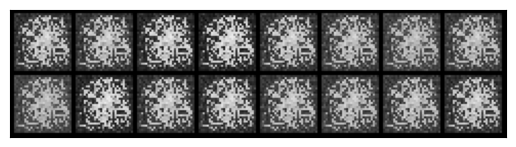

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


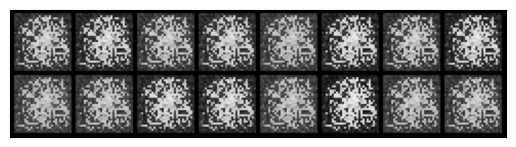

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


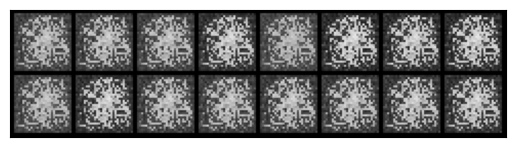

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


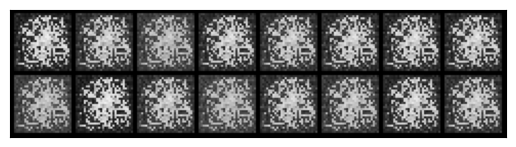

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


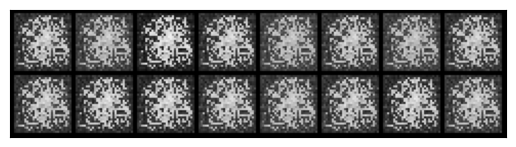

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


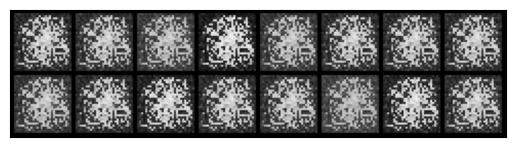

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


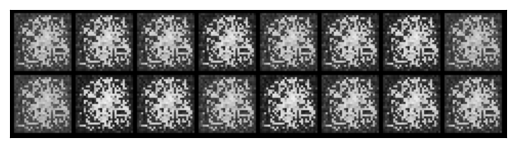

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


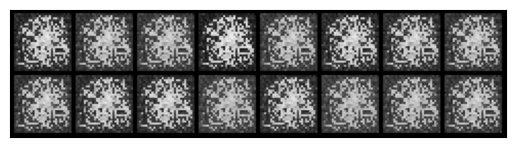

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


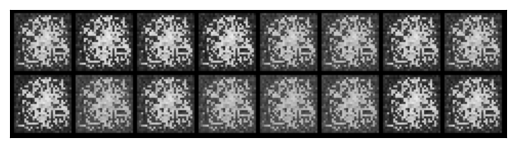

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


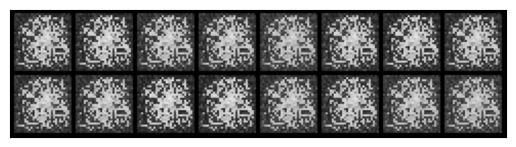

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


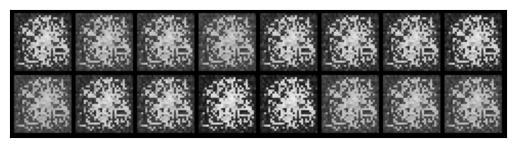

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


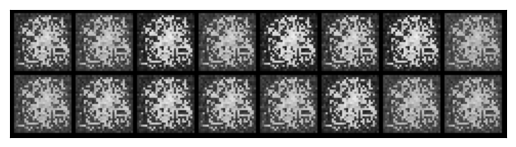

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


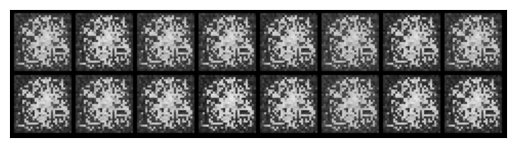

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


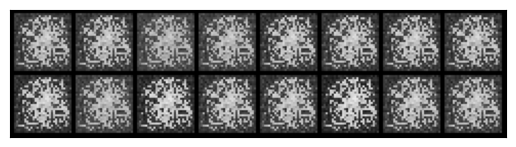

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


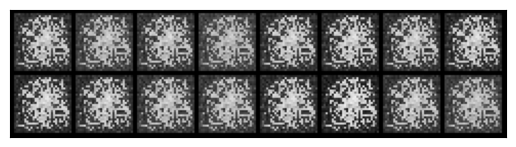

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


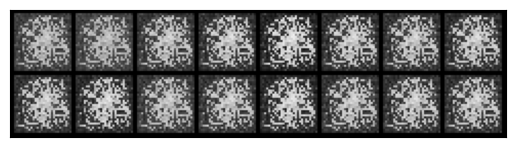

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


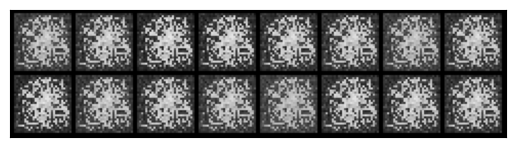

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


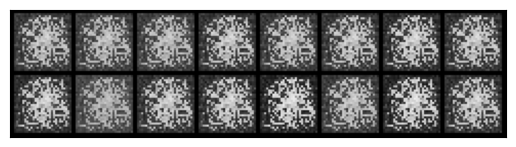

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


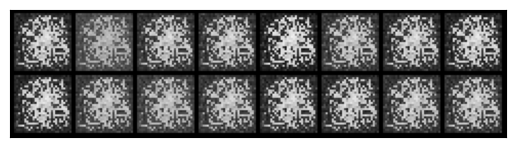

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


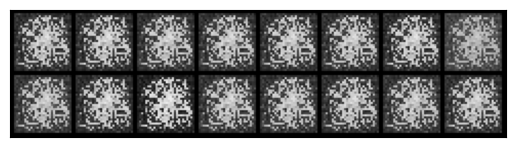

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


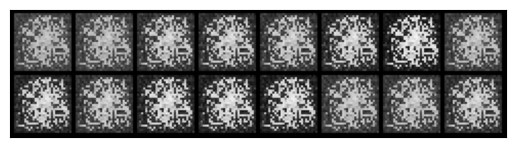

Epoch 3: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


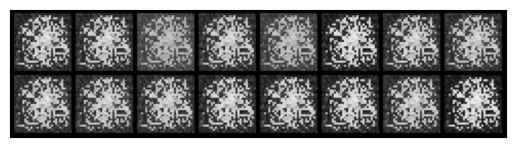


 80%|████████████████████████████████████         | 4/5 [03:08<00:48, 48.52s/it]

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


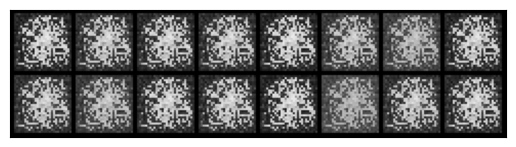

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


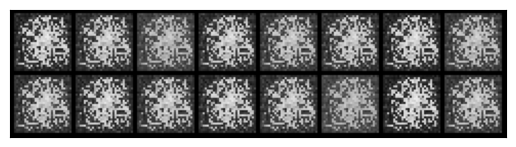

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


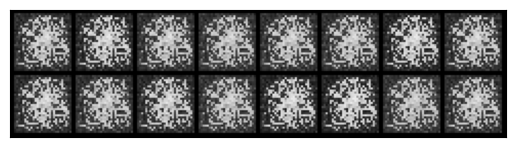

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


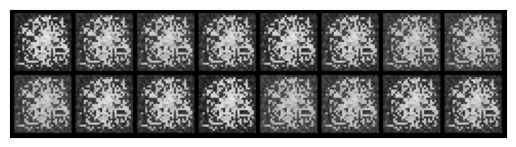

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


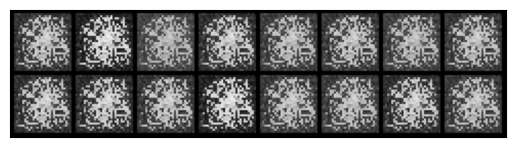

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


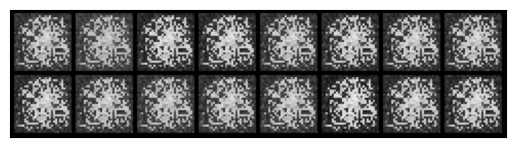

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


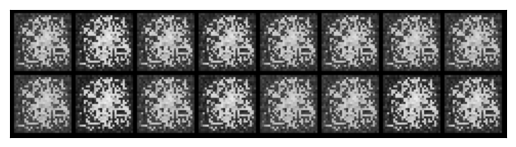

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


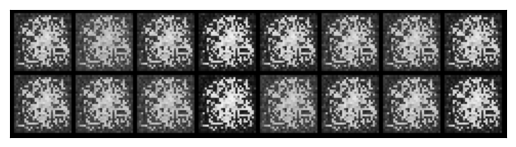

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


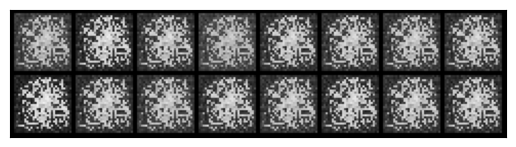

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


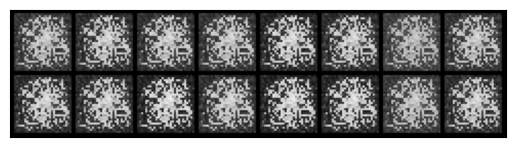

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


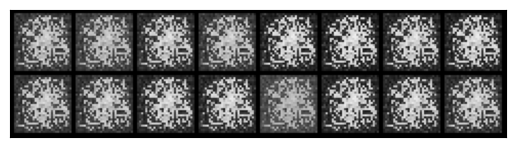

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


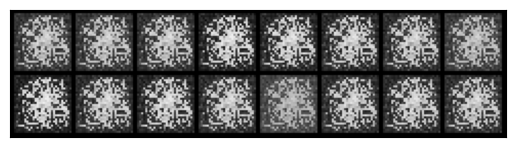

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


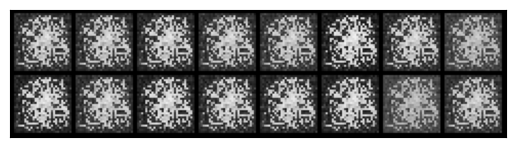

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


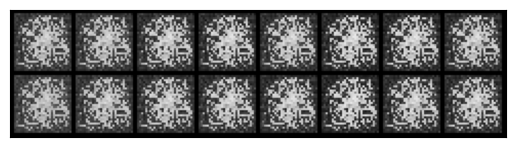

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


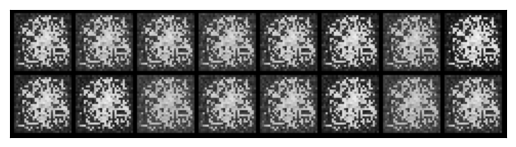

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


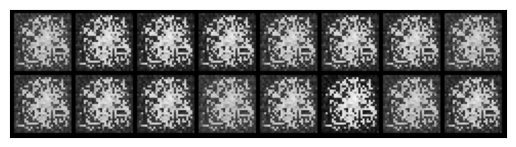

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


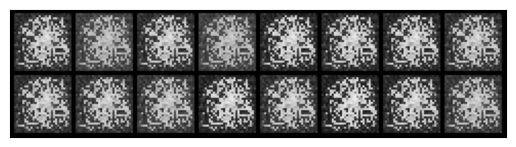

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


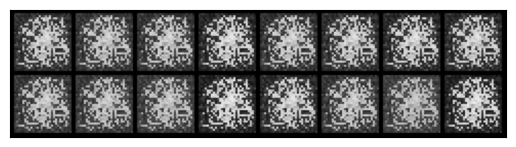

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


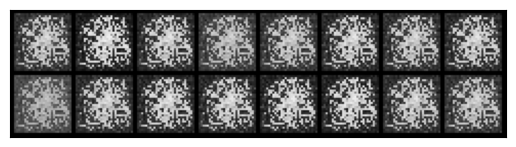

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


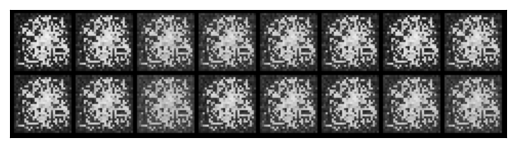

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


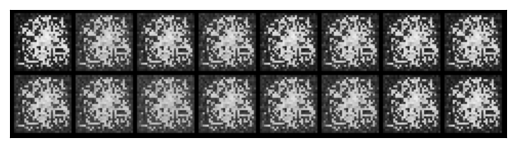

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


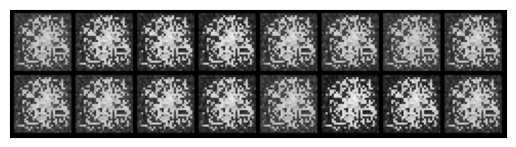

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


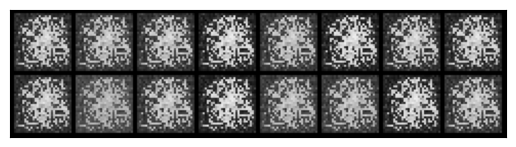

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


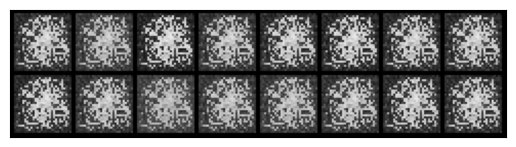

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


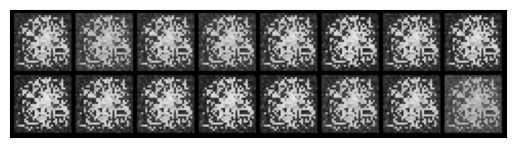

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


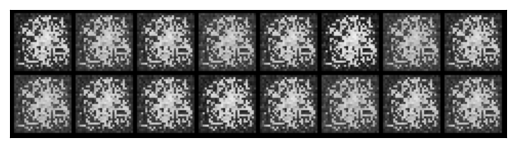

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


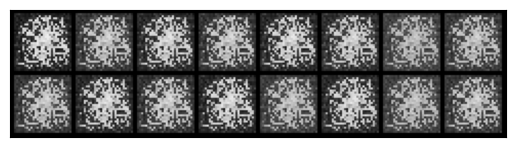

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


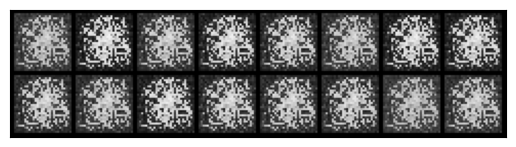

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


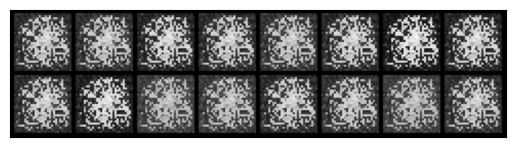

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


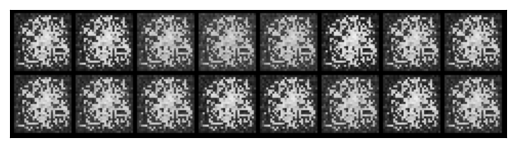

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


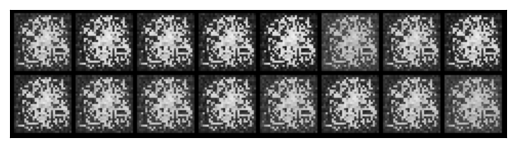

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


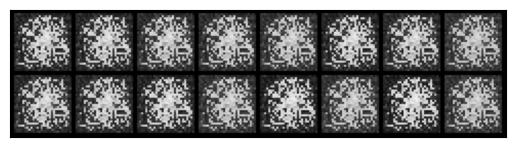

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


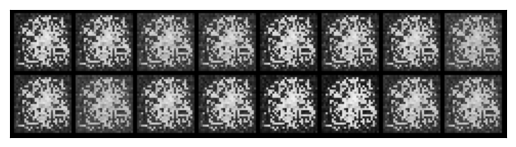

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


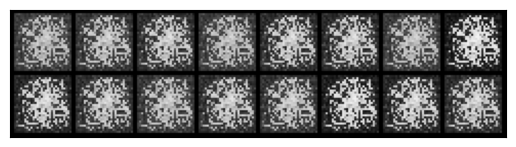

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


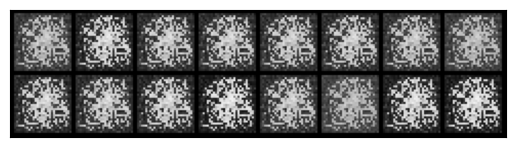

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


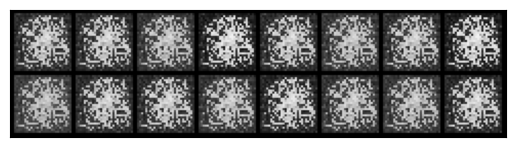

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


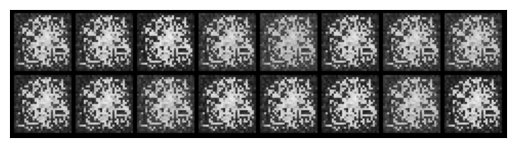

Epoch 4: |  
                      G_Loss: 0.000 | 
                      Fake_score_after_D_update: 1.000


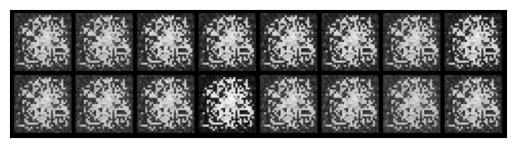

100%|█████████████████████████████████████████████| 5/5 [04:02<00:00, 48.50s/it]


In [34]:
# On training mode
netG.train()

# On eval mode: not training , computing weights
netD.eval()

num_epochs = 5

for epoch in tqdm(range(num_epochs)):
    
    for i, data in enumerate(fmnist_dl, 0):
        
        # Generate fake image batch with G
        noise = torch.randn(batch_size, 100)

        fake_images = netG(noise)
        real_labels = torch.full((batch_size,), real_label, dtype=torch.float)
        
        netG.zero_grad()
        
        output = netD(fake_images).view(-1)

        # For the generator, the discriminator to should classify fake images as real
        # Maximize the probability of this
        errG = criterion(output, real_labels)
        
        # Calculate gradients for G
        errG.backward()
        
        D_G_z2 = output.mean().item()
        
        # Update G
        g_optimizer.step()

        if i%100 == 0:
            print(f"""Epoch {epoch+0:01}: |  
                      G_Loss: {errG:.3f} | 
                      Fake_score_after_D_update: {D_G_z2:.3f}""")
            
            display_image_grid(
                epoch,i, fake_images.reshape(batch_size, 1, 28, 28).detach().cpu(), nrow = 8
            )

We don’t train the discriminator and the generator separately. In GAN training, we train the discriminator and generator networks in turn in the same training loop. If we train only the generator network first, the discriminator couldn’t distinguish between real and fake images well, and the loss value is not very useful. GAN training is tricky because we must train both to ensure both are learning harmoniously. We need to carefully balance and adjust learning rates for the discriminator and generator. If one network learns too fast, the other network may not learn very effectively. We want to achieve a win-win situation where both networks improve side-by-side.
Reference link-
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#training

First we will run the training for say 50 epochs

In [35]:
netG = Generator()

nedD = Discriminator()

d_optimizer = optim.Adam(netD.parameters(), lr = lr)

g_optimizer = optim.Adam(netG.parameters(), lr = lr)

In [36]:
G_losses = []
D_losses = []

real_score_list = []
fake_score_list = []

num_epochs = 40

fixed_noise = torch.randn(batch_size, 100)

netD.train()
netG.train()

Generator(
  (net): Sequential(
    (0): Linear(in_features=100, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=128, bias=True)
    (3): ReLU()
    (4): Linear(in_features=128, out_features=256, bias=True)
    (5): ReLU()
    (6): Linear(in_features=256, out_features=784, bias=True)
    (7): Tanh()
  )
)

## TODO Recording:

- When you run this scroll through the output slowly so we can see how the images improve

In [ ]:
for epoch in tqdm(range(num_epochs)):

    for i, data in enumerate(fmnist_dl, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        
        netD.zero_grad()

        real_images = data[0].reshape(batch_size, 1, 784)
        real_labels = torch.full((batch_size,), real_label, dtype = torch.float)

        output = netD(real_images).view(-1)

        errD_real = criterion(output, real_labels)

        errD_real.backward()
        
        D_x = output.mean().item()

        # Generate fake image batch with G
        noise = torch.randn(batch_size, 100)

        fake_images = netG(noise)
        fake_labels = torch.full((batch_size,), fake_label, dtype = torch.float)

        output = netD(fake_images.detach()).view(-1)

        errD_fake = criterion(output, fake_labels)
        
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()

        D_G_z1 = output.mean().item()
        
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        
        d_optimizer.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake_images).view(-1)
        
        # Maximize the probability that the discriminator categorizes fake 
        # images as real
        errG = criterion(output, real_labels)
        
        errG.backward()
        
        D_G_z2 = output.mean().item()
        
        g_optimizer.step()

        if (i % 200 == 0) or ((epoch == num_epochs-1) and (i == len(fmnist_dl) - 1)):
            print(f"""Epoch {epoch+0:01}: |
                      Step: {i} | 
                      D_real Loss: {errD_real:.3f} | 
                      D_fake Loss: {errD_fake:.3f} | 
                      D_total Loss: {errD:.3f} | 
                      G_Loss: {errG:.3f} |
                      Real_score {D_x:.3f} | 
                      Fake_score {D_G_z1:.3f} |
                      Fake_score_after_D_update: {D_G_z2:.3f}
            """)
            
            # View the output of the GAN every so often
            with torch.no_grad():
                fake_images = netG(fixed_noise).reshape(batch_size, 1, 28, 28).detach().cpu()
                display_image_grid(epoch, i, fake_images, nrow = 8)
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        real_score_list.append(D_x)
        fake_score_list.append(D_G_z1)

: 

 First, we will see how D and G’s losses changed during training.Discriminator loss is increasing and Generator loss is decreasing Real score and Fake score are converging to 0.5

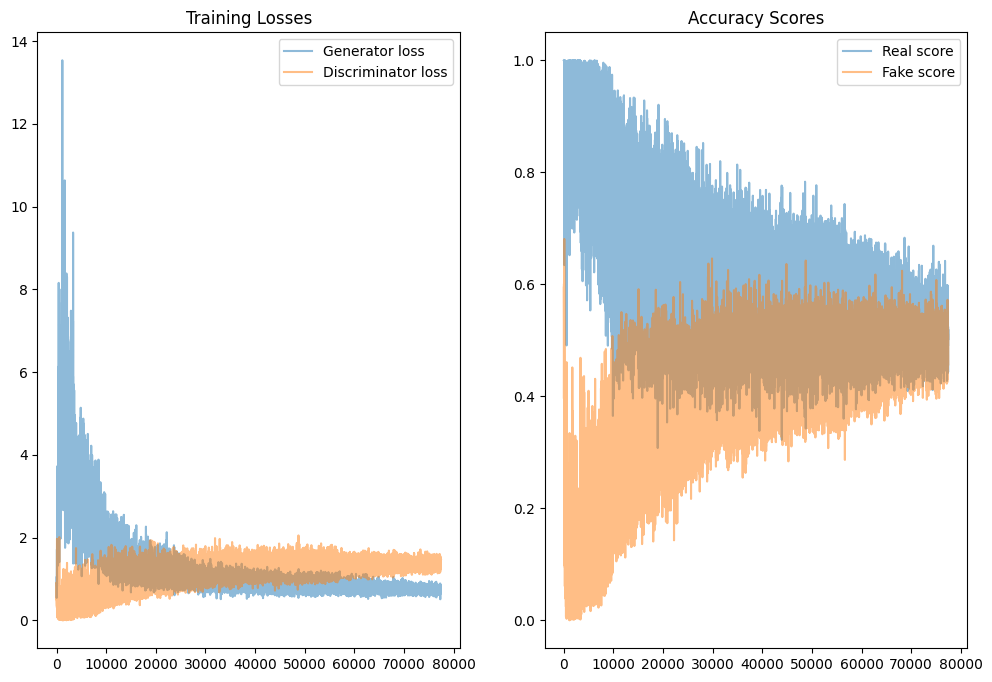

In [38]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 8))

ax1.plot(G_losses, label = 'Generator loss', alpha = 0.5)
ax1.plot(D_losses, label = 'Discriminator loss', alpha = 0.5)
ax1.legend()

ax1.set_title('Training Losses')
ax2.plot(real_score_list, label = 'Real score', alpha = 0.5)
ax2.plot(fake_score_list, label = 'Fake score', alpha = 0.5)
ax2.set_title('Accuracy Scores')

ax2.legend()

If instead of displaying step wise results, we want to display average  epoch wise losses and scores, we can store avg values in separate lists

In [39]:
netG = Generator()

nedD = Discriminator()

d_optimizer = optim.Adam(netD.parameters(), lr = lr)

g_optimizer = optim.Adam(netG.parameters(), lr = lr)

In [40]:
avg_G_losses = []
avg_D_losses = []
avg_real_score_list = []
avg_fake_score_list = []

num_epochs = 40

fixed_noise = torch.randn(batch_size, 100)

netD.train()
netG.train()

Generator(
  (net): Sequential(
    (0): Linear(in_features=100, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=128, bias=True)
    (3): ReLU()
    (4): Linear(in_features=128, out_features=256, bias=True)
    (5): ReLU()
    (6): Linear(in_features=256, out_features=784, bias=True)
    (7): Tanh()
  )
)

In [ ]:
for epoch in tqdm(range(num_epochs)):

    G_losses = []
    D_losses = []

    real_score_list=[]
    fake_score_list=[]

    for i, data in enumerate(fmnist_dl, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        
        netD.zero_grad()

        real_images = data[0].reshape(batch_size, 1, 784)
        real_labels = torch.full((batch_size,), real_label, dtype = torch.float)

        output = netD(real_images).view(-1)
        errD_real = criterion(output, real_labels)
        errD_real.backward()
        
        D_x = output.mean().item()

        # Generate fake image batch with G
        noise = torch.randn(batch_size, 100)
        fake_images = netG(noise)
        fake_labels = torch.full((batch_size,), fake_label, dtype = torch.float)

        output = netD(fake_images.detach()).view(-1)
        errD_fake = criterion(output, fake_labels)
        errD_fake.backward()

        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        
        d_optimizer.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        
        output = netD(fake_images).view(-1)
        errG = criterion(output, real_labels)
        
        errG.backward()
        
        D_G_z2 = output.mean().item()
        g_optimizer.step()

        if (i % 200 == 0) or ((epoch == num_epochs-1) and (i == len(fmnist_dl) - 1)):
            print(f"""Epoch {epoch+0:01}: |
                      Step: {i} | 
                      D_real Loss: {errD_real:.3f} | 
                      D_fake Loss: {errD_fake:.3f} | 
                      D_total Loss: {errD:.3f} | 
                      G_Loss: {errG:.3f} |
                      Real_score {D_x:.3f} | 
                      Fake_score {D_G_z1:.3f} |
                      Fake_score_after_D_update: {D_G_z2:.3f}
            """)
            
            with torch.no_grad():
                fake_images = netG(fixed_noise).reshape(batch_size, 1, 28, 28).detach().cpu()
                display_image_grid(epoch, i, fake_images, nrow = 8)
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        real_score_list.append(D_x)
        fake_score_list.append(D_G_z1)

    avg_G_losses.append(np.mean(G_losses))
    avg_D_losses.append(np.mean(D_losses))
    avg_real_score_list.append(np.mean(real_score_list))
    avg_fake_score_list.append(np.mean(fake_score_list))



: 

As we are recording loss data and scores epoch wise, Smooth curve can be seen

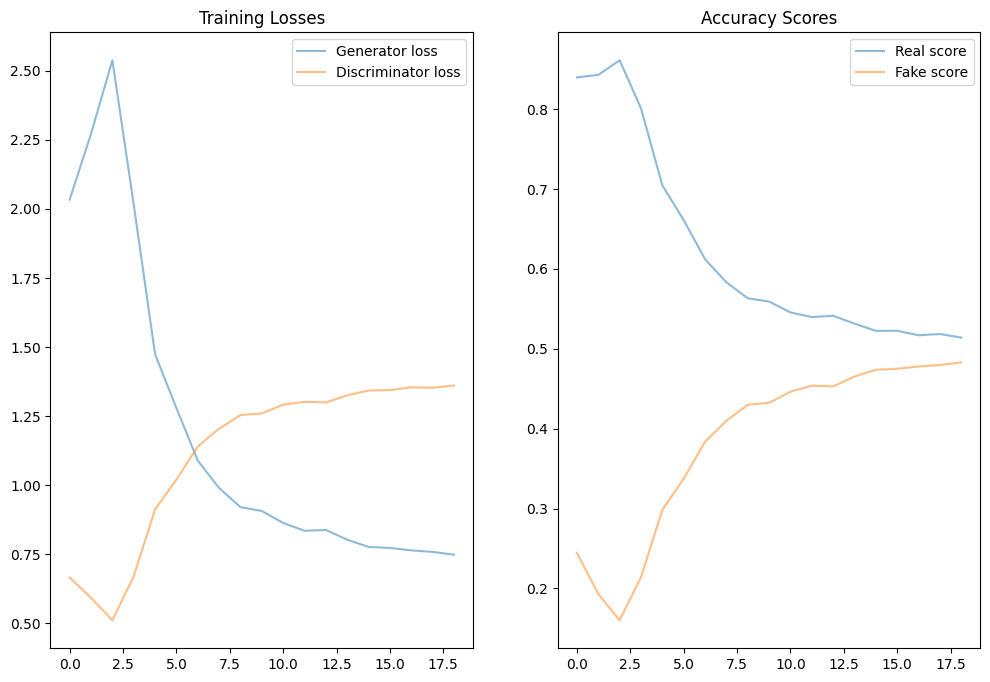

In [107]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 8))

ax1.plot(avg_G_losses, label = 'Generator loss', alpha = 0.5)
ax1.plot(avg_D_losses, label = 'Discriminator loss', alpha = 0.5)
ax1.legend()
ax1.set_title('Training Losses')

ax2.plot(avg_real_score_list, label = 'Real score', alpha = 0.5)
ax2.plot(avg_fake_score_list, label = 'Fake score', alpha = 0.5)
ax2.set_title('Accuracy Scores')

ax2.legend()